# Analysis and Visualization for Migros-Denner chain
## Group Project / CA

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import json

In [2]:
df = pd.read_csv('.data/df_switzerland_denner.csv')

In [11]:
df.columns

Index(['Address', 'Street Name', 'Zip Code', 'City', 'Canton', 'Country',
       'Latitude', 'Longitude', 'Rating', 'Number of Ratings', 'Place Name',
       'Place ID', 'Sunday_Open', 'Monday_Open', 'Tuesday_Open',
       'Wednesday_Open', 'Thursday_Open', 'Friday_Open', 'Saturday_Open',
       'Sunday_Close', 'Monday_Close', 'Tuesday_Close', 'Wednesday_Close',
       'Thursday_Close', 'Friday_Close', 'Saturday_Close'],
      dtype='object')

In [9]:
# Getting coordinates for cantons 
with open(".data/georef-switzerland-kanton@public.geojson") as response:
    cantons = json.load(response)

cantons["features"][0]["properties"]

{'geo_point_2d': {'lon': 8.756666184200009, 'lat': 47.061777487306394},
 'year': '2023',
 'kan_code': ['05'],
 'kan_name': ['Schwyz'],
 'kan_area_code': 'CHE',
 'kan_type': 'Kanton'}

In [13]:
df1 = df.copy()

In [12]:
cantons_dict = {'TG':'Thurgau', 'GR':'Graubünden', 'LU':'Luzern', 'BE':'Bern', 'VS':'Valais', 
                'BL':'Basel-Landschaft', 'SO':'Solothurn', 'VD':'Vaud', 'SH':'Schaffhausen', 'ZH':'Zürich', 
                'AG':'Aargau', 'UR':'Uri', 'NE':'Neuchâtel', 'TI':'Ticino', 'SG':'St. Gallen', 'GE':'Genève', 
                'GL':'Glarus', 'JU':'Jura', 'ZG':'Zug', 'OW':'Obwalden', 'FR':'Fribourg', 'SZ':'Schwyz', 
                'AR':'Appenzell Ausserrhoden', 'AI':'Appenzell Innerrhoden', 'NW':'Nidwalden', 'BS':'Basel-Stadt'}

In [14]:
denner_per_canton = df1.groupby('Canton').size().reset_index(name='count')
denner_per_canton

,Canton,count
0,Aargau,18
1,Basel-Landschaft,1
2,Basel-Stadt,18
3,Bern,21
4,Fribourg,8
5,Graubünden,20
6,Jura,4
7,Luzern,19
8,Neuchâtel,5
9,Nidwalden,4


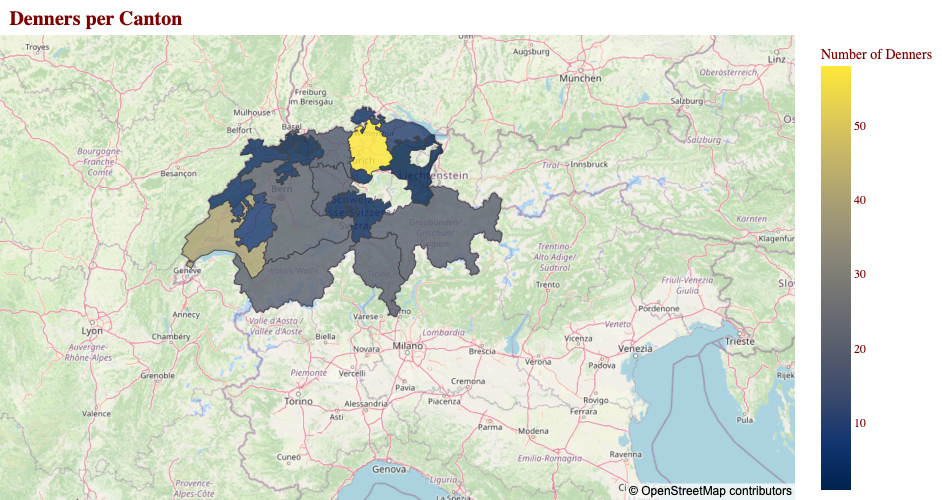

In [16]:
# mapping denners per canton
fig = px.choropleth_mapbox(
    denner_per_canton, 
    color="count",
    geojson=cantons, 
    locations="Canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"Canton":"Canton",
           "count":"Number of Denners"},
    title="<b>Denners per Canton</b>",
    color_continuous_scale="Cividis",
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Sans",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )
fig.show()

In [17]:
df.head()

,Address,Street Name,Zip Code,City,Canton,Country,Latitude,Longitude,Rating,Number of Ratings,...,Thursday_Open,Friday_Open,Saturday_Open,Sunday_Close,Monday_Close,Tuesday_Close,Wednesday_Close,Thursday_Close,Friday_Close,Saturday_Close
0,"Oberwiesenstrasse 63, 8500 Frauenfeld, Switzer...",Oberwiesenstrasse 63,8500,Frauenfeld,Thurgau,Switzerland,47.556742,8.881299,4.2,175,...,730.0,730.0,730.0,NaN,2000.0,2000.0,2000.0,2000.0,2000.0,1800.0
1,"Zürcherstrasse 297, 8500 Frauenfeld, Switzerland",Zürcherstrasse 297,8500,Frauenfeld,Thurgau,Switzerland,47.563861,8.908164,4.2,126,...,800.0,800.0,800.0,NaN,2000.0,2000.0,2000.0,2000.0,2000.0,1800.0
2,"Konstanzerstrasse 28, 9512 Rossrüti, Switzerland",Konstanzerstrasse 28,9512,Rossrüti,St. Gallen,Switzerland,47.474162,9.062305,4.5,135,...,700.0,700.0,700.0,NaN,1900.0,1900.0,1900.0,1900.0,1900.0,1700.0
3,"Zürcherstrasse 65 / 67, 8500 Frauenfeld, Switz...",Zürcherstrasse 65 / 67,8500,Frauenfeld,Thurgau,Switzerland,47.552677,8.884368,4.0,204,...,730.0,730.0,730.0,NaN,2000.0,2000.0,2000.0,2000.0,2000.0,1800.0
4,"Tägerwilerstrasse 6, 8280 Kreuzlingen, Switzer...",Tägerwilerstrasse 6,8280,Kreuzlingen,Zürich,Switzerland,47.655582,9.163516,4.3,216,...,730.0,730.0,730.0,NaN,2000.0,2000.0,2000.0,2000.0,2000.0,2000.0


In [20]:
rating_per_canton = df1.groupby('Canton')['Rating'].agg('mean').reset_index(name='mean_rating')
sorted_rating = rating_per_canton.sort_values(by='mean_rating', ascending=False)

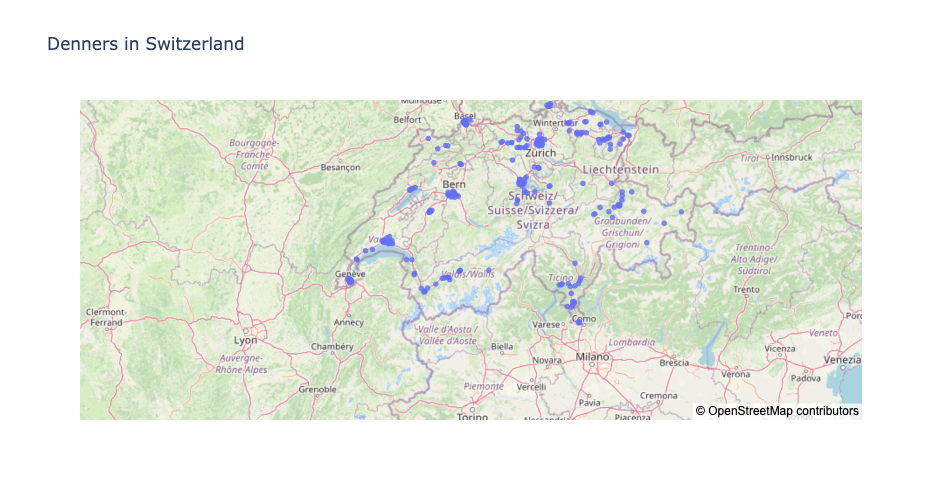

In [27]:

fig = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude", center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    title="Denners in Switzerland")
    #labels={"Canton":"Canton"})

fig.show()

In [49]:
population = pd.read_csv('pop_denn.csv')
population

,canton,2022,denners
0,Vaud,"830,431",40.0
1,Valais,"357,282",21.0
2,Geneva,"514,114",NaN
3,Bern,"1,051,437",21.0
4,Fribourg,"334,465",8.0
5,Solothurn,"282,408",3.0
6,Neuchâtel,"176,571",5.0
7,Jura,"73,865",4.0
8,Basel-Stadt,"196,786",18.0
9,Basel-Landschaft,"294,417",1.0


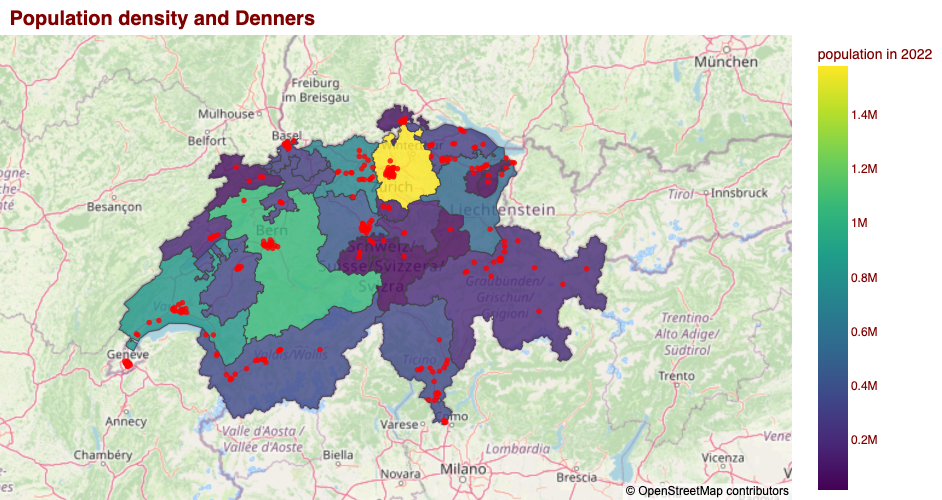

In [48]:
fig = px.choropleth_mapbox(
    population, 
    color='2022',
    color_continuous_scale='viridis',
    geojson=cantons, 
    locations="canton", 
    featureidkey="properties.kan_name",
    center={"lat": 46.8, "lon": 8.3},
    mapbox_style="open-street-map", 
    zoom=6.3,
    opacity=0.8,
    width=900,
    height=500,
    labels={"canton":"Canton",
           "2022":"population in 2022"},
    title="<b>Population density and Denners</b>"
    
)
fig.update_layout(margin={"r":0,"t":35,"l":0,"b":0},
                  font={"family":"Helvetica",
                       "color":"maroon"},
                  hoverlabel={"bgcolor":"white", 
                              "font_size":12,
                             "font_family":"Helvetica"},
                  title={"font_size":20,
                        "xanchor":"left", "x":0.01,
                        "yanchor":"bottom", "y":0.95}
                 )

fig2 = px.scatter_mapbox(df1, lat="Latitude", lon="Longitude",
                         size_max=15,  # Color the dots based on a column
                         color_discrete_sequence=["red"], # Choose a color scale
                         center={"lat": 46.8, "lon": 8.3},
                         mapbox_style="open-street-map", 
                         zoom=6.3,
                         opacity=0.8,
                         width=900,
                         height=500) 
trace0 = fig2 # the second map from the previous code
fig.add_trace(trace0.data[0])
trace0.layout.update(showlegend=False)
fig.show()

In [44]:
population['2022'] = population['2022'].str.replace(',', '').astype(int)
population['2022']

0      830431
1      357282
2      514114
3     1051437
4      334465
5      282408
6      176571
7       73865
8      196786
9      294417
10     711232
11    1579967
12      41471
13      85214
14      55759
15      16416
16     525967
17     202538
18     289650
19     424851
20      37317
21     164920
22      38700
23      44420
24     131164
25     354023
Name: 2022, dtype: int64

## Analysis of population and projections

In [3]:
# Loading data on the population projection
#projection = pd.read_csv('projections_pop.csv')

In [4]:
# Percentage change calculation

projection['per_change_10y'] = (projection['2030'] - projection['2020'])/projection['2020'] * 100
projection['per_change_20y'] = (projection['2040'] - projection['2020'])/projection['2020'] * 100

In [5]:
#projection.to_csv('per_change.csv')

In [6]:
# Preparing data for the column chart on the projection of the population 
projection = pd.read_csv('.data/per_change.csv')
viz1 = projection[['Canton','per_change_10y', 'per_change_20y']]
viz1 = viz1.sort_values(by='per_change_20y', ascending=False)

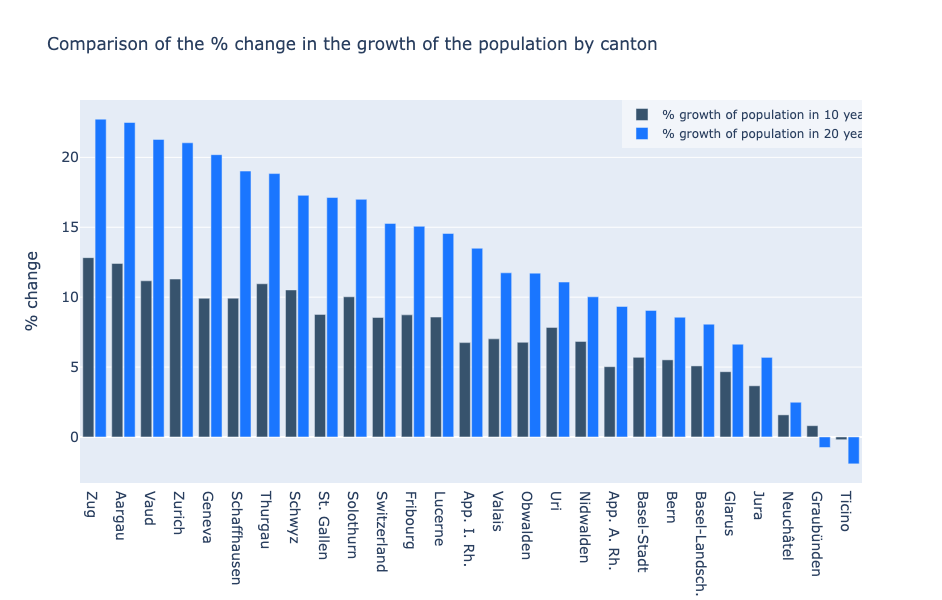

In [8]:
# Column chart for the 10 and 20 years population projection
fig = go.Figure()
fig.add_trace(go.Bar(x=viz1['Canton'],
                y=viz1['per_change_10y'],
                name='% growth of population in 10 years',
                marker_color='rgb(55, 83, 109)'
                ))
fig.add_trace(go.Bar(x=viz1['Canton'],
                y=viz1['per_change_20y'],
                name='% growth of population in 20 years',
                marker_color='rgb(26, 118, 255)'
                ))

fig.update_layout(
    title='Comparison of the % change in the growth of the population by canton',
    xaxis_tickfont_size=14,
    yaxis=dict(
        title='% change',
        titlefont_size=16,
        tickfont_size=14,
    ),
    legend=dict(
        x=0,
        y=1.0,
        bgcolor='rgba(255, 255, 255, 0)',
        bordercolor='rgba(255, 255, 255, 0)'
    ),
    barmode='group',
    bargap=0.15, # gap between bars of adjacent location coordinates.
    bargroupgap=0.1,
    width=1000, # Set the width of the figure
    height=600 # gap between bars of the same location coordinate.
)

fig.update_layout(
    legend=dict(
        x=1,
        y=1,
        xanchor='right',  # Anchors the legend to the right
        yanchor='top',
        bgcolor='rgba(255, 255, 255, 0.5)'  # Anchors the legend to the bottom
    )
)

fig.show()